In [2]:
from datetime import datetime
import csv
from datetime import datetime
from __future__ import division

from collections import defaultdict
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt

#Challenge 1

In [3]:
#Group version
cols = ['ca', 'unit', 'scp', 'station', 'linename', 'division', 'date', 'time', 'desc', 'entries', 'exits']

traffic = pd.read_csv('turnstile_150110.txt', header = False, names = cols)

traffic2 = traffic[:1000]

trafficDict = defaultdict(list)
for i in range(len(traffic2)):
    row = traffic2.ix[i]
    trafficTup = row.ca, row.unit, row.scp, row.station
    trafficDict[trafficTup].append([row.linename, row.division, row.date, row.time, row.desc, row.entries, row.exits])

In [4]:
#Jon's version
with open('turnstile_150110.txt') as f:
    reader = csv.reader(f)
    rows = [[cell.strip() for cell in row] for row in reader]

In [5]:
#Jon's version
assert rows.pop(0) == ['C/A', 'UNIT', 'SCP', 'STATION', 'LINENAME',
                       'DIVISION', 'DATE', 'TIME', 'DESC', 'ENTRIES',
                       'EXITS']

In [6]:
#Jon's version
raw_readings = {}
for row in rows:
    raw_readings.setdefault(tuple(row[:4]), []).append(row[4:])

In [7]:
#Jon's version
raw_readings.items()[0:2]

[(('A030', 'R083', '01-06-00', '23 ST-5 AVE'),
  [['NR',
    'BMT',
    '01/03/2015',
    '03:00:00',
    'REGULAR',
    '0005585420',
    '0003141272'],
   ['NR',
    'BMT',
    '01/03/2015',
    '07:00:00',
    'REGULAR',
    '0005585431',
    '0003141279'],
   ['NR',
    'BMT',
    '01/03/2015',
    '11:00:00',
    'REGULAR',
    '0005585499',
    '0003141380'],
   ['NR',
    'BMT',
    '01/03/2015',
    '15:00:00',
    'REGULAR',
    '0005585731',
    '0003141606'],
   ['NR',
    'BMT',
    '01/03/2015',
    '19:00:00',
    'REGULAR',
    '0005586046',
    '0003141826'],
   ['NR',
    'BMT',
    '01/03/2015',
    '23:00:00',
    'REGULAR',
    '0005586227',
    '0003141907'],
   ['NR',
    'BMT',
    '01/04/2015',
    '03:00:00',
    'REGULAR',
    '0005586298',
    '0003141916'],
   ['NR',
    'BMT',
    '01/04/2015',
    '07:00:00',
    'REGULAR',
    '0005586304',
    '0003141921'],
   ['NR',
    'BMT',
    '01/04/2015',
    '11:00:00',
    'REGULAR',
    '0005586347',
    '0003

In [8]:
csv.reader

<function _csv.reader>

#Challenge 2

In [9]:
#Group version

import dateutil
traffic['elapsed'] = traffic['entries'].diff()

trafficDict2 = defaultdict(list)

previous = traffic.ix[0].entries 
for i in range(len(traffic)):
    row = traffic.ix[i]
    trafficTup = row.ca, row.unit, row.scp, row.station
    trafficDict2[trafficTup].append([datetime.strptime(' '.join([row.date, row.time]), '%m/%d/%Y %H:%M:%S'), row.elapsed])

print trafficDict2.items()

[(('A030', 'R083', '01-06-00', '23 ST-5 AVE'), [[datetime.datetime(2015, 1, 3, 3, 0), -70034.0], [datetime.datetime(2015, 1, 3, 7, 0), 11.0], [datetime.datetime(2015, 1, 3, 11, 0), 68.0], [datetime.datetime(2015, 1, 3, 15, 0), 232.0], [datetime.datetime(2015, 1, 3, 19, 0), 315.0], [datetime.datetime(2015, 1, 3, 23, 0), 181.0], [datetime.datetime(2015, 1, 4, 3, 0), 71.0], [datetime.datetime(2015, 1, 4, 7, 0), 6.0], [datetime.datetime(2015, 1, 4, 11, 0), 43.0], [datetime.datetime(2015, 1, 4, 15, 0), 187.0], [datetime.datetime(2015, 1, 4, 19, 0), 236.0], [datetime.datetime(2015, 1, 4, 23, 0), 142.0], [datetime.datetime(2015, 1, 5, 3, 0), 23.0], [datetime.datetime(2015, 1, 5, 7, 0), 25.0], [datetime.datetime(2015, 1, 5, 11, 0), 429.0], [datetime.datetime(2015, 1, 5, 15, 0), 320.0], [datetime.datetime(2015, 1, 5, 19, 0), 1079.0], [datetime.datetime(2015, 1, 5, 23, 0), 445.0], [datetime.datetime(2015, 1, 6, 3, 0), 79.0], [datetime.datetime(2015, 1, 6, 7, 0), 22.0], [datetime.datetime(2015, 1

"\ntraffic2 = traffic.groupby(['ca', 'unit', 'scp', 'station'])\ntraffic['EntryDeltas'] = traffic2.entries.diff()\n## we are dropping the nan's that result from diff()\ntraffic = traffic.dropna(subset = ['EntryDeltas'])\nstation_dailies = traffic.groupby(['date','station'])['EntryDeltas'].sum()\nprint station_dailies\n"

In [10]:
#Jon's version

datetime_cumulative = {turnstile: [(datetime.strptime(date + time,
                                                      '%m/%d/%Y%X'),
                                    int(in_cumulative))
                                   for _, _, date, time,
                                       _, in_cumulative, _ in rows]
                       for turnstile, rows in raw_readings.items()}
datetime_cumulative

{('A030',
  'R083',
  '01-06-00',
  '23 ST-5 AVE'): [(datetime.datetime(2015, 1, 3, 3, 0),
   5585420), (datetime.datetime(2015, 1, 3, 7, 0), 5585431), (datetime.datetime(2015, 1, 3, 11, 0),
   5585499), (datetime.datetime(2015, 1, 3, 15, 0),
   5585731), (datetime.datetime(2015, 1, 3, 19, 0), 5586046), (datetime.datetime(2015, 1, 3, 23, 0),
   5586227), (datetime.datetime(2015, 1, 4, 3, 0),
   5586298), (datetime.datetime(2015, 1, 4, 7, 0), 5586304), (datetime.datetime(2015, 1, 4, 11, 0),
   5586347), (datetime.datetime(2015, 1, 4, 15, 0),
   5586534), (datetime.datetime(2015, 1, 4, 19, 0), 5586770), (datetime.datetime(2015, 1, 4, 23, 0),
   5586912), (datetime.datetime(2015, 1, 5, 3, 0),
   5586935), (datetime.datetime(2015, 1, 5, 7, 0), 5586960), (datetime.datetime(2015, 1, 5, 11, 0),
   5587389), (datetime.datetime(2015, 1, 5, 15, 0),
   5587709), (datetime.datetime(2015, 1, 5, 19, 0), 5588788), (datetime.datetime(2015, 1, 5, 23, 0),
   5589233), (datetime.datetime(2015, 1, 6, 3, 0

In [11]:
#Jon's version
for rows in datetime_cumulative.values():
    assert rows == sorted(rows)

In [12]:
#Jon's version
datetime_count_times = {turnstile: [[rows[i][0],
                                     rows[i+1][1] - rows[i][1],
                                     rows[i+1][0] - rows[i][0]]
                                    for i in range(len(rows) - 1)]
                        for turnstile, rows in datetime_cumulative.items()}
print datetime_count_times

{('A030', 'R083', '01-06-00', '23 ST-5 AVE'): [[datetime.datetime(2015, 1, 3, 3, 0), 11, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 3, 7, 0), 68, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 3, 11, 0), 232, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 3, 15, 0), 315, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 3, 19, 0), 181, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 3, 23, 0), 71, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 3, 0), 6, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 7, 0), 43, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 11, 0), 187, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 15, 0), 236, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 19, 0), 142, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 4, 23, 0), 23, datetime.timedelta(0, 14400)], [datetime.datetime(2015, 1, 5, 3, 0), 25, datetime.timedelta(0, 

In [13]:
#Jon's version
all_counts = [count for rows in datetime_count_times.values() for _, count, _ in rows]
all_counts.sort()
print all_counts[-50:]

[2604, 2613, 2614, 2621, 2622, 2638, 2641, 2647, 2663, 2673, 2674, 2674, 2674, 2675, 2676, 2677, 2694, 2700, 2711, 2725, 2735, 2738, 2741, 2751, 2772, 2775, 2787, 2832, 2844, 2847, 2851, 2851, 2854, 2880, 3025, 3026, 3070, 3114, 3154, 3156, 3177, 3196, 3657, 3675, 29981, 805923, 33434066, 83048263, 802134830, 1684308558]


In [14]:
#Jon's version
print all_counts[:1200]

[-1213847, -805074, -609887, -603840, -538428, -402458, -322152, -242560, -198239, -178788, -166608, -137609, -115847, -52689, -42813, -29572, -23097, -14454, -9282, -1579, -1435, -1398, -1309, -1305, -1301, -1294, -1290, -1279, -1277, -1228, -1227, -1217, -1205, -1204, -1202, -1201, -1196, -1195, -1186, -1185, -1153, -1151, -1149, -1146, -1136, -1092, -1060, -1047, -1017, -1009, -985, -972, -924, -921, -909, -905, -903, -896, -893, -889, -881, -877, -864, -858, -854, -819, -813, -787, -780, -776, -767, -743, -735, -735, -703, -701, -696, -692, -685, -681, -677, -676, -660, -644, -640, -635, -633, -631, -627, -625, -625, -623, -622, -621, -620, -619, -617, -614, -611, -601, -595, -593, -581, -577, -575, -574, -573, -571, -570, -564, -564, -562, -559, -559, -558, -556, -554, -552, -552, -551, -551, -550, -549, -548, -544, -543, -529, -528, -521, -518, -518, -516, -506, -503, -500, -495, -492, -490, -482, -470, -469, -462, -456, -455, -455, -450, -440, -439, -438, -437, -437, -436, -434,

In [15]:
#Jon's version
all_times = [duration.total_seconds() / 60 / 60
             for rows in datetime_count_times.values()
             for _, _, duration in rows]
print Counter(all_times).most_common(10)

[(4.0, 170160), (4.2, 10526), (0.02222222222222222, 924), (8.0, 473), (0.022500000000000003, 446), (4.433333333333334, 156), (0.017777777777777778, 84), (0.02277777777777778, 58), (12.0, 43), (0.02, 43)]


In [16]:
#Jon's version
datetime_counts = {turnstile: [(time, count)
                               for (time, count, _) in rows
                               if 0 <= count <= 5000]
                   for turnstile, rows in datetime_count_times.items()}

In [17]:
#Jon's version
all_good_counts = [count for rows in datetime_counts.values() for _, count in rows]
print len(all_good_counts) / len(all_counts)

0.996831548352


In [18]:
#Jon's version
all_good_counts.sort()
print all_good_counts[-5:]

[3156, 3177, 3196, 3657, 3675]


In [19]:
#Jon's version
print all_good_counts[:5]

[0, 0, 0, 0, 0]


#Challenge 3

In [20]:
#Group version
#traffic2 = traffic.groupby(['ca', 'unit', 'scp', 'station'])
#traffic['EntryDeltas'] = traffic2.entries.diff()[
#traffic['EntryDeltas']

print type(trafficDict2)

for k in trafficDict2.items():
    print k

<type 'collections.defaultdict'>
(('A030', 'R083', '01-06-00', '23 ST-5 AVE'), [[datetime.datetime(2015, 1, 3, 3, 0), -70034.0], [datetime.datetime(2015, 1, 3, 7, 0), 11.0], [datetime.datetime(2015, 1, 3, 11, 0), 68.0], [datetime.datetime(2015, 1, 3, 15, 0), 232.0], [datetime.datetime(2015, 1, 3, 19, 0), 315.0], [datetime.datetime(2015, 1, 3, 23, 0), 181.0], [datetime.datetime(2015, 1, 4, 3, 0), 71.0], [datetime.datetime(2015, 1, 4, 7, 0), 6.0], [datetime.datetime(2015, 1, 4, 11, 0), 43.0], [datetime.datetime(2015, 1, 4, 15, 0), 187.0], [datetime.datetime(2015, 1, 4, 19, 0), 236.0], [datetime.datetime(2015, 1, 4, 23, 0), 142.0], [datetime.datetime(2015, 1, 5, 3, 0), 23.0], [datetime.datetime(2015, 1, 5, 7, 0), 25.0], [datetime.datetime(2015, 1, 5, 11, 0), 429.0], [datetime.datetime(2015, 1, 5, 15, 0), 320.0], [datetime.datetime(2015, 1, 5, 19, 0), 1079.0], [datetime.datetime(2015, 1, 5, 23, 0), 445.0], [datetime.datetime(2015, 1, 6, 3, 0), 79.0], [datetime.datetime(2015, 1, 6, 7, 0), 2

In [21]:
#Jon's version
day_counts = {}
for turnstile, rows in datetime_counts.items():
    by_day = {}
    for time, count in rows:
        day = time.date()
        by_day[day] = by_day.get(day, 0) + count
    day_counts[turnstile] = sorted(by_day.items())

print len(day_counts)

4557


#Challenge 4

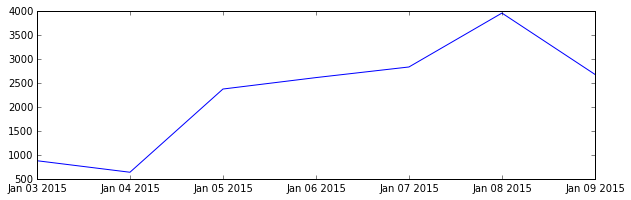

In [22]:
%matplotlib inline
#print day_counts[('A030', 'R083', '01-06-00', '23 ST-5 AVE')]

date_list = []
count_list = []
for station in day_counts[('A030', 'R083', '01-06-00', '23 ST-5 AVE')]:
    date_list.append(station[0])
    count_list.append(station[1])

plt.figure(figsize=(10,3))
plt.plot(date_list, count_list)


#Challenge 5

In [41]:
total = 0
station_sum = []
station_list = []
total_list = []
day_counts = sorted(day_counts)
for a in day_counts:
    print a
for k, v in day_counts.iteritems():
    for item in v:
        total = total + item[1]
    station_sum.append(total)
    total = 0
    station_list.append(k)

i = 0
    
total_list = zip(station_list, station_sum)
total_list = sorted(total_list)

('A002', 'R051', '02-00-00', 'LEXINGTON AVE')
('A002', 'R051', '02-00-01', 'LEXINGTON AVE')
('A002', 'R051', '02-03-00', 'LEXINGTON AVE')
('A002', 'R051', '02-03-01', 'LEXINGTON AVE')
('A002', 'R051', '02-03-02', 'LEXINGTON AVE')
('A002', 'R051', '02-03-03', 'LEXINGTON AVE')
('A002', 'R051', '02-03-04', 'LEXINGTON AVE')
('A002', 'R051', '02-03-05', 'LEXINGTON AVE')
('A002', 'R051', '02-03-06', 'LEXINGTON AVE')
('A002', 'R051', '02-05-00', 'LEXINGTON AVE')
('A002', 'R051', '02-05-01', 'LEXINGTON AVE')
('A002', 'R051', '02-06-00', 'LEXINGTON AVE')
('A006', 'R079', '00-00-00', '5 AVE-59 ST')
('A006', 'R079', '00-00-01', '5 AVE-59 ST')
('A006', 'R079', '00-00-02', '5 AVE-59 ST')
('A006', 'R079', '00-00-03', '5 AVE-59 ST')
('A006', 'R079', '00-00-04', '5 AVE-59 ST')
('A006', 'R079', '00-03-00', '5 AVE-59 ST')
('A006', 'R079', '00-03-01', '5 AVE-59 ST')
('A006', 'R079', '00-03-02', '5 AVE-59 ST')
('A007', 'R079', '01-05-00', '5 AVE-59 ST')
('A007', 'R079', '01-05-01', '5 AVE-59 ST')
('A007',

AttributeError: 'list' object has no attribute 'iteritems'

#Challenge 6

In [125]:
import operator
import numpy as np

station_list = []
count_list = []
unique_counts = []
i = 0

for k in total_list:
    station_list.append(k[0][3])
    count_list.append(k[1])
    i += 1
    
station_counts = sorted(zip(station_list, count_list))

i = 0
theCount = 0
while i < len(station_counts) - 1:
    if station_counts[i][0] == station_counts[i + 1][0]:
        theCount = theCount + station_counts[i][1]
    if station_counts[i][0] != station_counts[i + 1][0]:
        unique_counts.append(theCount)
        theCount = 0
    i += 1

if station_counts[len(station_counts)-2][0] == station_counts[len(station_counts)-1][0]:
    unique_counts.append(theCount)

date_list
unique_station_counts = zip(station_list, unique_counts)
print unique_station_counts

[('1 AVE', 115901), ('103 ST', 178546), ('103 ST-CORONA', 95137), ('104 ST', 7779), ('110 ST', 54655), ('110 ST-CATHEDRL', 60643), ('110 ST-CPN', 42858), ('111 ST', 67311), ('116 ST', 189243), ('116 ST-COLUMBIA', 45314), ('121 ST', 9594), ('125 ST', 418045), ('135 ST', 107865), ('137 ST-CITY COL', 62114), ('138 ST-3 AVE', 33625), ('138 ST-GR CONC', 11339), ('14 ST', 214852), ('14 ST-6 AVE', 97491), ('14 ST-UNION SQ', 569161), ('145 ST', 195644), ('148 ST-LENOX', 16056), ('149 ST-3 AVE', 124794), ('149 ST-GR CONC', 41177), ('14TH STREET', 35383), ('15 ST-PROSPECT', 23773), ('155 ST', 29436), ('157 ST', 44524), ('161 ST-YANKEE', 123170), ('163 ST-AMSTERDM', 15703), ('167 ST', 96181), ('168 ST-BROADWAY', 128925), ('169 ST', 42592), ('170 ST', 79649), ('174 ST', 26603), ('174-175 ST', 23095), ('175 ST', 57621), ('176 ST', 25810), ('18 AVE', 78062), ('18 ST', 35430), ('181 ST', 115831), ('182-183 ST', 19026), ('183 ST', 24967), ('190 ST', 15793), ('191 ST', 37811), ('2 AVE', 81972), ('20 AV

#Challenge 7

ValueError: invalid literal for float(): 1 AVE

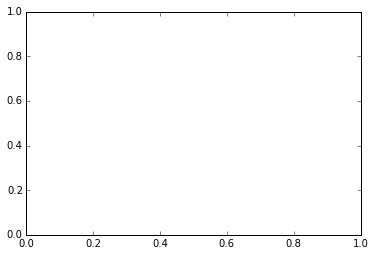

In [126]:
%matplotlib inline

plt.figure()
plt.plot(station_list, unique_counts)